In [3]:
pip install --upgrade pip

   ---------------------------------------- 0.0/2.1 MB ? eta -:--:--
    --------------------------------------- 0.0/2.1 MB 1.3 MB/s eta 0:00:02
   - -------------------------------------- 0.1/2.1 MB 1.2 MB/s eta 0:00:02
   ---- ----------------------------------- 0.2/2.1 MB 1.7 MB/s eta 0:00:02
   -------- ------------------------------- 0.4/2.1 MB 2.4 MB/s eta 0:00:01
   ------------ --------------------------- 0.6/2.1 MB 2.9 MB/s eta 0:00:01
   --------------- ------------------------ 0.8/2.1 MB 3.1 MB/s eta 0:00:01
   ------------------------ --------------- 1.3/2.1 MB 4.4 MB/s eta 0:00:01
   ---------------------------------------  2.1/2.1 MB 5.8 MB/s eta 0:00:01
   ---------------------------------------- 2.1/2.1 MB 5.8 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 23.3.2
    Uninstalling pip-23.3.2:
      Successfully uninstalled pip-23.3.2
Note: you may need to restart the kernel to use updated packages.


In [1]:
pip install pydotplus

DEPRECATION: Configuring installation scheme with distutils config files is deprecated and will no longer work in the near future. If you are using a Homebrew or Linuxbrew Python, please see discussion at https://github.com/Homebrew/homebrew-core/issues/76621
DEPRECATION: Configuring installation scheme with distutils config files is deprecated and will no longer work in the near future. If you are using a Homebrew or Linuxbrew Python, please see discussion at https://github.com/Homebrew/homebrew-core/issues/76621

[notice] A new release of pip is available: 23.3.2 -> 24.0
[notice] To update, run: python3.9 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install graphviz

DEPRECATION: Configuring installation scheme with distutils config files is deprecated and will no longer work in the near future. If you are using a Homebrew or Linuxbrew Python, please see discussion at https://github.com/Homebrew/homebrew-core/issues/76621
DEPRECATION: Configuring installation scheme with distutils config files is deprecated and will no longer work in the near future. If you are using a Homebrew or Linuxbrew Python, please see discussion at https://github.com/Homebrew/homebrew-core/issues/76621

[notice] A new release of pip is available: 23.3.2 -> 24.0
[notice] To update, run: python3.9 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn import datasets
from sklearn.inspection import DecisionBoundaryDisplay
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import plot_tree
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, roc_curve, accuracy_score, precision_score, recall_score, mean_absolute_error, classification_report, roc_auc_score, mean_squared_error
from sklearn import tree
from sklearn.tree import export_graphviz
import pydotplus
from IPython.display import Image

In [57]:
data = datasets.load_breast_cancer()

df = pd.DataFrame(data.data, columns=data.feature_names)
df['target'] = data.target

In [18]:
df.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,0
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,0
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,0
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,0
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,0


In [64]:
X = data.data
y = data.target

X_train, X_test, y_train, y_test = train_test_split(X, y,  test_size=0.3, random_state=987)

In [16]:
rand_for = RandomForestClassifier(max_depth = 5, n_estimators = 10, min_samples_split = 5)

parameters = {'max_depth': [1, 2, 3, 5, 10, 12, 14, 16], 'n_estimators': [100, 101, 111, 10, 15, 3, 5], 'min_samples_split': [0, 1, 5, 10, 20]}

rand_for = GridSearchCV(rand_for, parameters)
rand_for.fit(X_train, y_train)

print(rand_for.best_estimator_)
print(rand_for.best_params_)
print(rand_for.best_score_)

RandomForestClassifier(max_depth=10, min_samples_split=5, n_estimators=15)
{'max_depth': 10, 'min_samples_split': 5, 'n_estimators': 15}
0.957373417721519


C:\Users\User\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\model_selection\_validation.py:425: FitFailedWarning: 
560 fits failed out of a total of 1400.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
280 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\User\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\User\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "C:\Users\User\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\base.py

In [94]:
rand_for = RandomForestClassifier(max_depth = 2, n_estimators = 100, min_samples_split = 5)
rand_for.fit(X_train, y_train)
y_pred = rand_for.predict(X_test)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Precision:", precision_score(y_test, y_pred))
print("Recall:", recall_score(y_test, y_pred))

Accuracy: 0.9590643274853801
Precision: 0.9649122807017544
Recall: 0.9734513274336283


Confusion Matrix:
[[ 55   3]
 [  1 112]]


<Figure size 500x500 with 0 Axes>

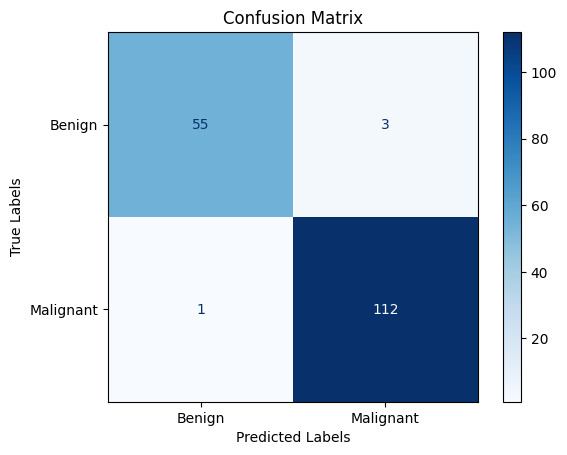

In [93]:
# Вывод матрицы ошибок
cf_matrix = confusion_matrix(y_test, y_pred, labels=np.unique(y))
print("Confusion Matrix:")
print(cf_matrix)

# Визуализация матрицы ошибок
plt.figure(figsize=(5, 5))
ConfusionMatrixDisplay(cf_matrix).plot(cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks([0, 1], ['Benign', 'Malignant'])
plt.yticks([0, 1], ['Benign', 'Malignant'])
plt.show()

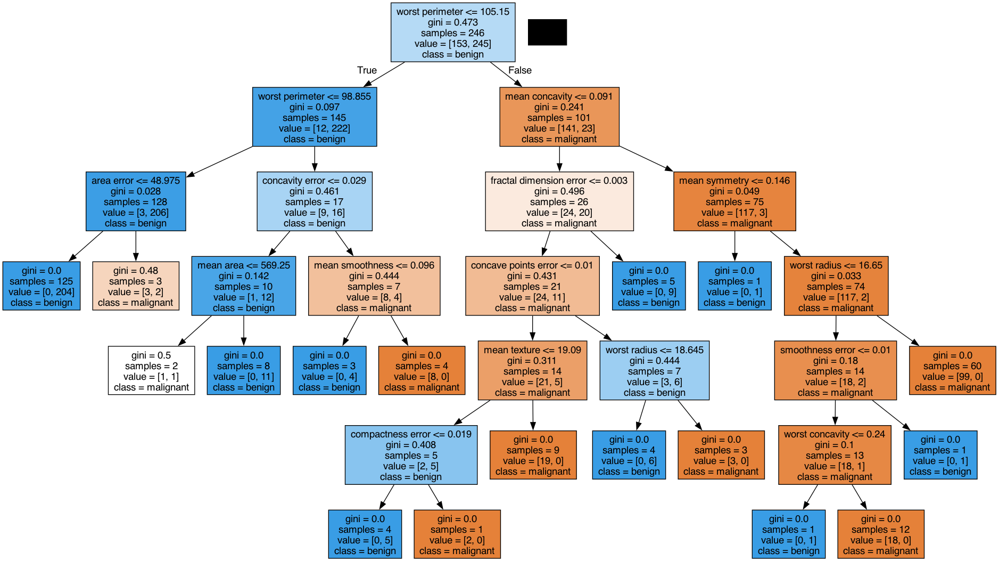

In [39]:
tree = rand_for.estimators_[0]
export_graphviz(tree, out_file='tree.dot', feature_names=data.feature_names, class_names=data.target_names, filled=True)

graph = pydotplus.graph_from_dot_file('tree.dot')
graph.write_png('tree.png')

Image(graph.create_png())

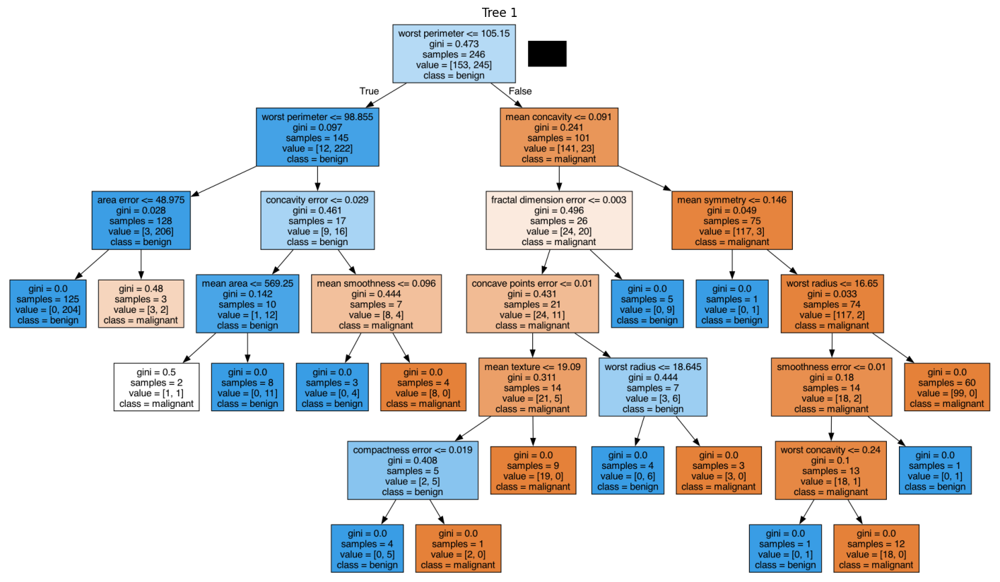

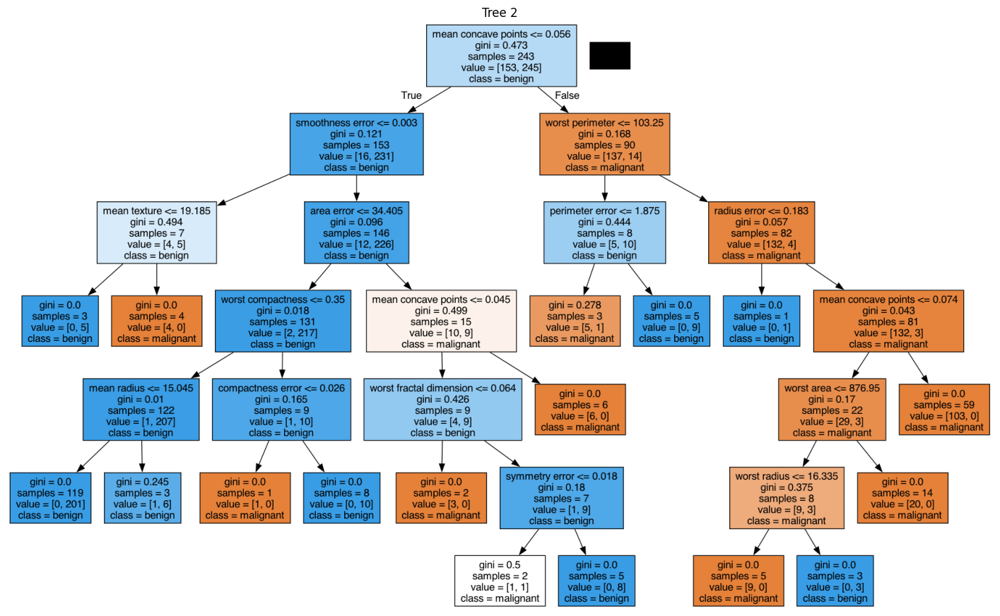

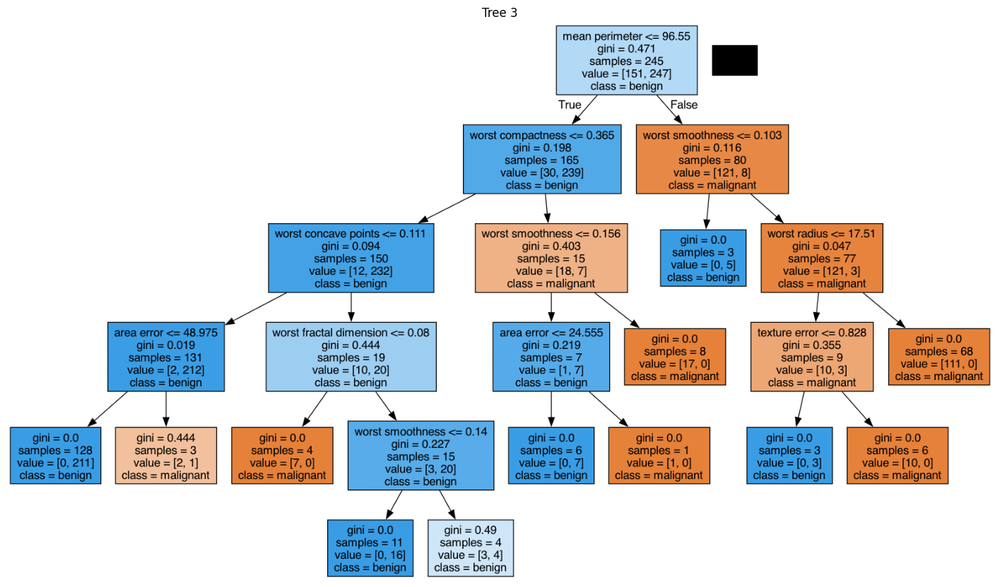

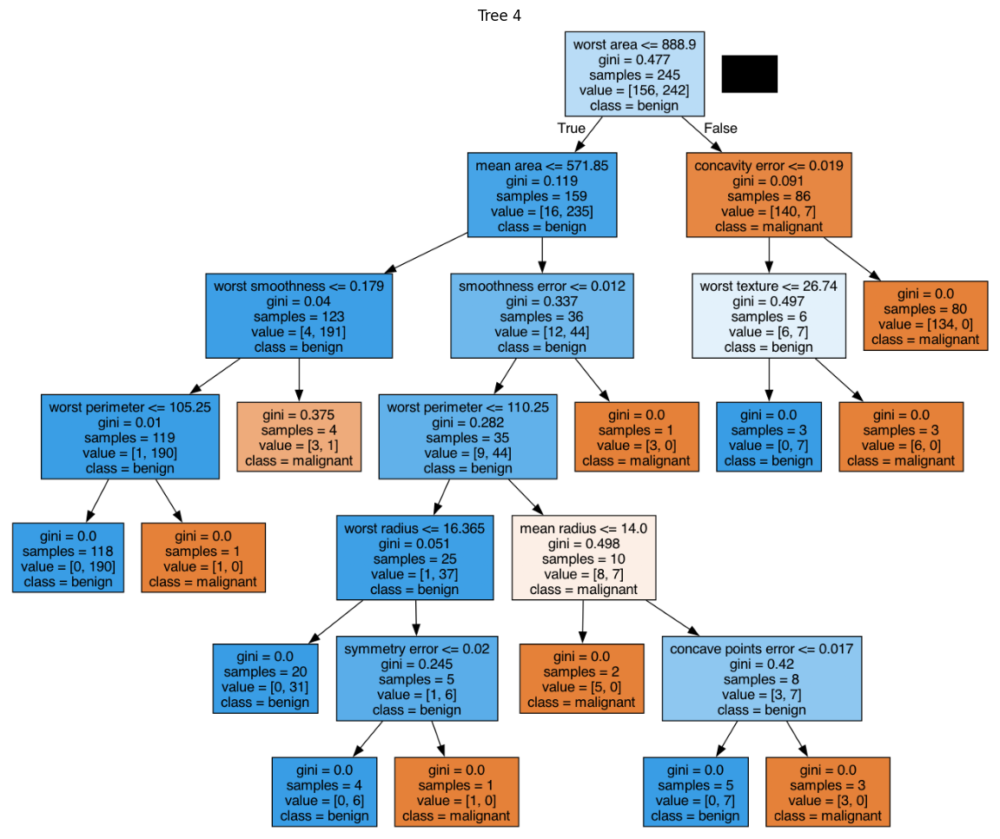

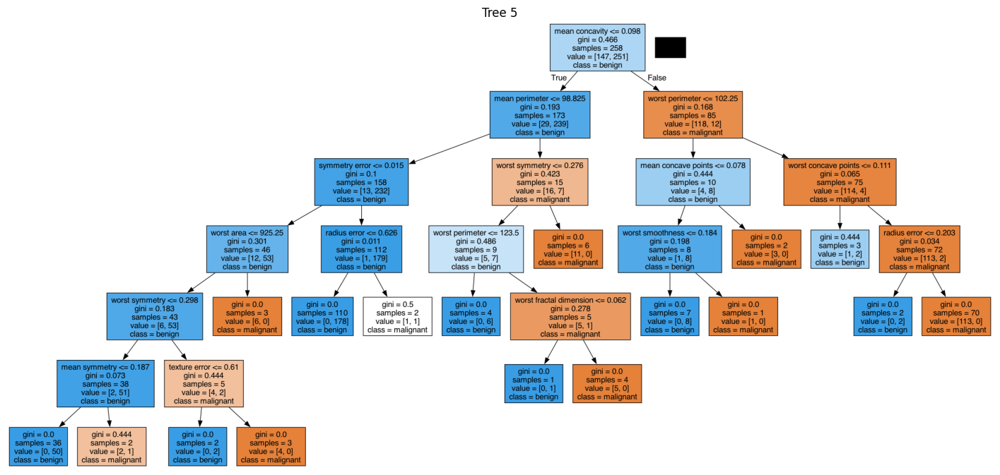

...

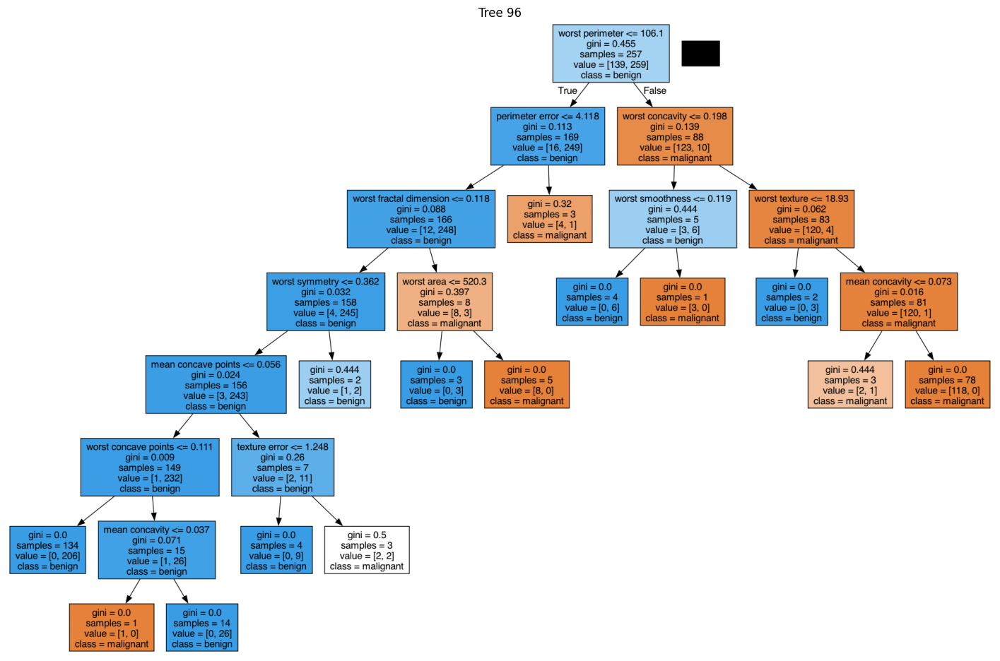

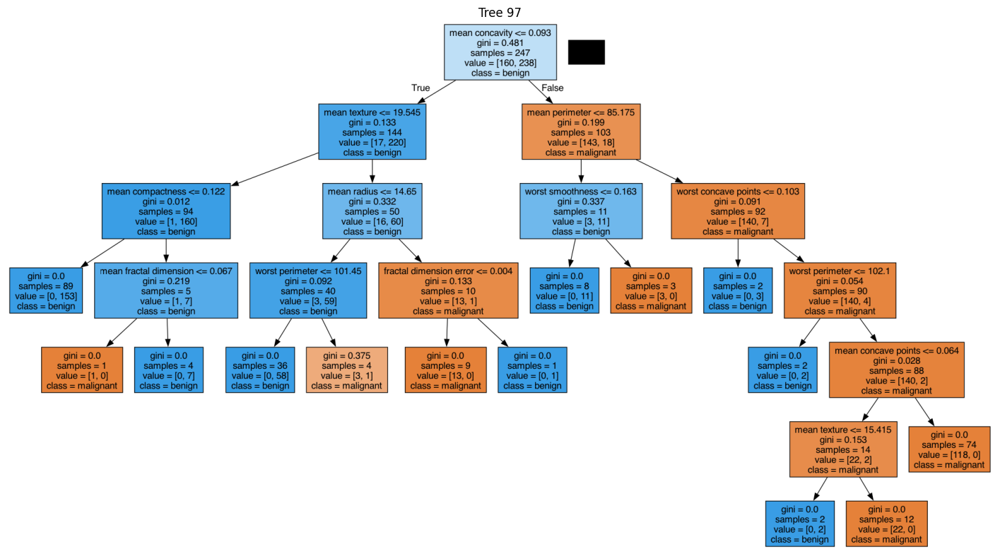

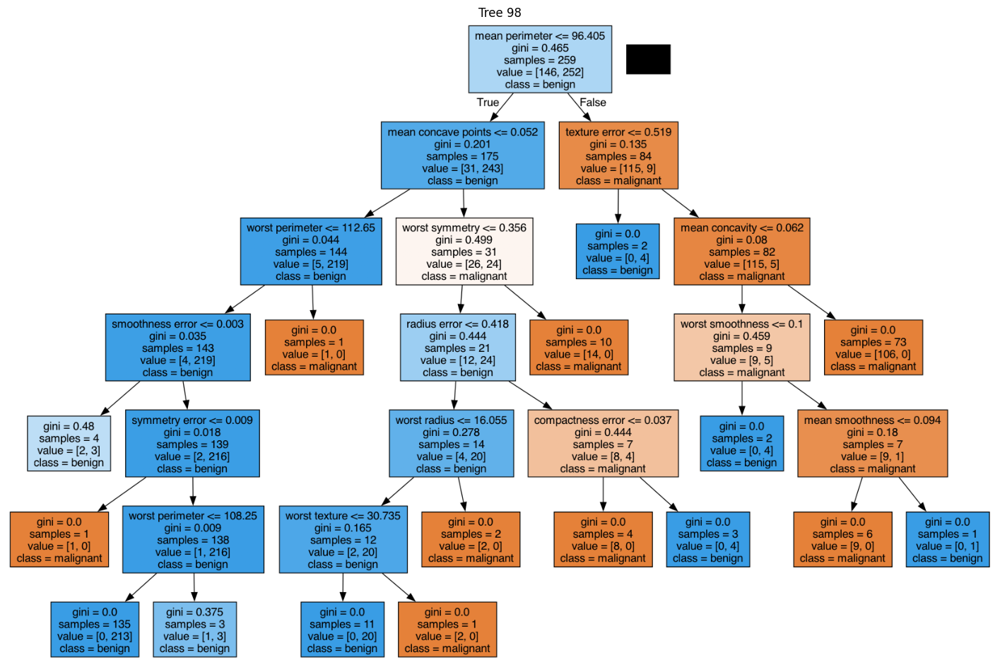

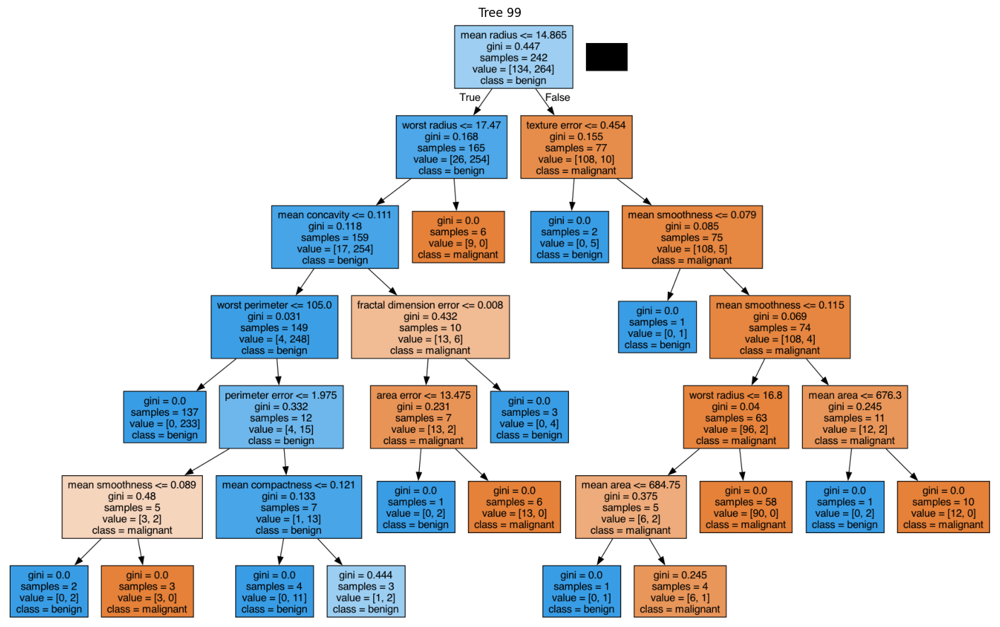

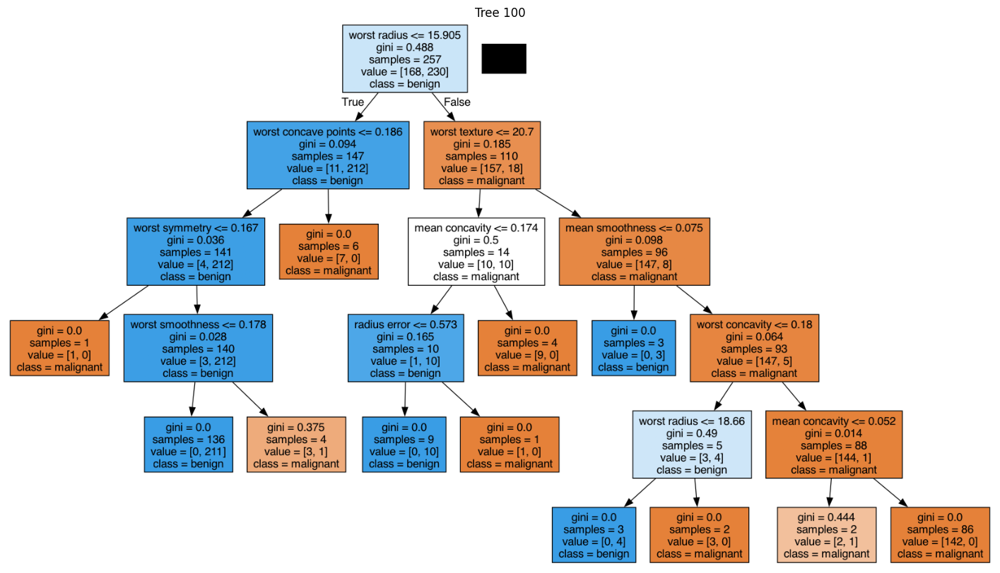

In [40]:
# Визуализация всех деревьев в случайном лесе
for i, tree_in_forest in enumerate(rand_for.estimators_):
    export_graphviz(tree_in_forest, out_file=f'tree_{i}.dot', feature_names=data.feature_names, class_names=data.target_names, filled=True)
    graph = pydotplus.graph_from_dot_file(f'tree_{i}.dot')
    graph.write_png(f'tree_{i}.png')

    plt.figure(figsize=(18, 12))
    plt.imshow(plt.imread(f'tree_{i}.png'))
    plt.axis('off')
    plt.title(f'Tree {i + 1}')
    plt.show()